<a href="https://colab.research.google.com/github/imjinan/portfolioProjects/blob/main/Jinan_Abdul_Kareem.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# COMP-1800-M01 COURSEWORK

CHRISCO is a fictional but very successful company managing retail outlets across the UK. They collect a range of data about the number of customers visiting their every outlet using its loyalty card scheme. the data has been stored to analyze their 45 outlets and find some insight

# PIP INSTALL

In [2]:
! pip install hvplot


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.2/3.2 MB 28.0 MB/s eta 0:00:00


# Basic Library Import

In [3]:
# Importing Libraries

import pandas as pd
import numpy as np
import hvplot.pandas
import holoviews as hv
import panel as pn

pn.extension(comms='colab')

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE

# Data visualization and exploration

## Dataframe 1: Listing the daily number of customersvisits to the company's outlets

## Data Loading

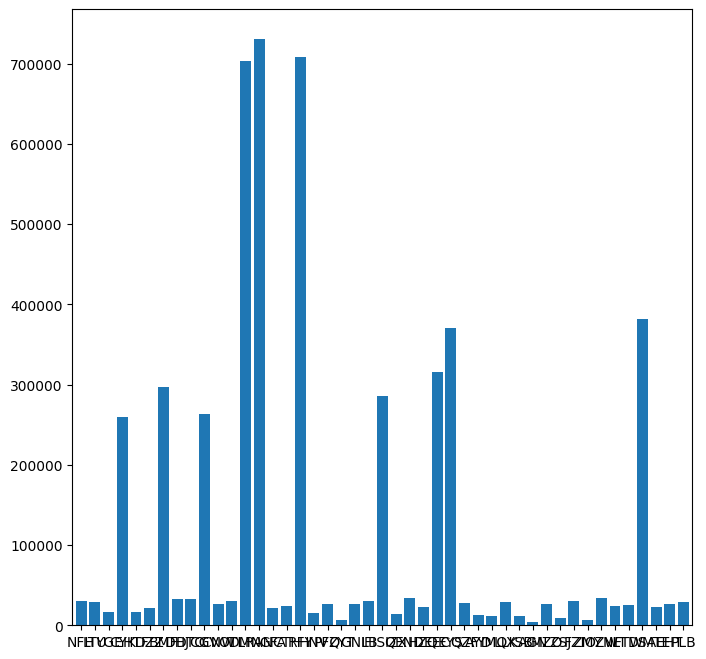

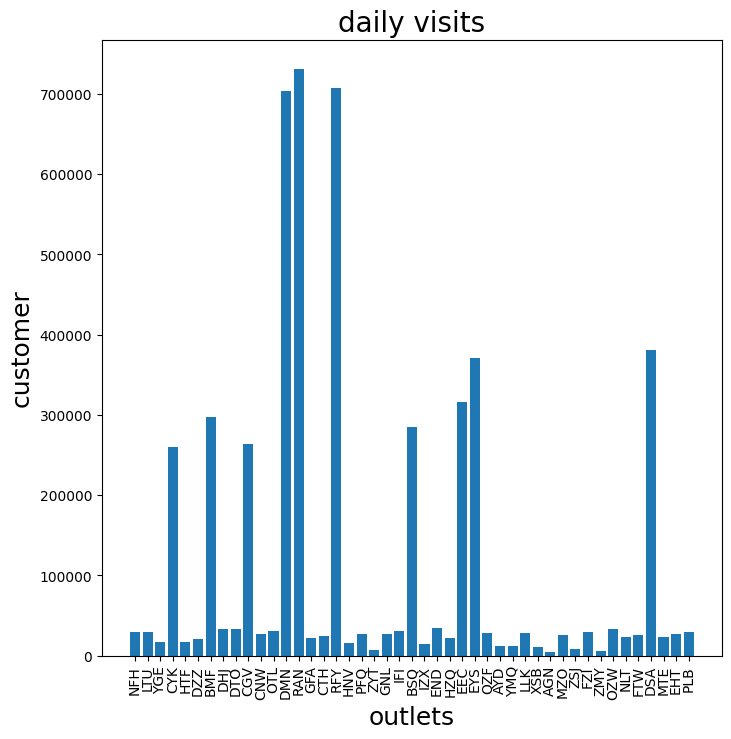

In [4]:


jk = pd.read_csv('https://tinyurl.com/ChrisCoDV/001272844/OutletDailyCustomers.csv', index_col=0)
jk.index = pd.to_datetime(jk.index)
jk.sum().plot.bar(width=0.8, rot=0, figsize=(8, 8))
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(jk.columns))
plt.bar(x_pos, jk.sum(), align='center')
plt.xticks(x_pos, jk.columns, rotation = 90)
plt.xlabel('outlets', fontsize=18)
plt.ylabel('customer', fontsize=18)
plt.title('daily visits', fontsize=20)
plt.show()


In [5]:
# checking to find out if the dataset contains any negative values.
outlets = jk.columns
print('Verifying the number of negatives values: (As, the number of visitors never be a negative value)')


for outlet in outlets:
  negative_values_count_check = (jk[outlet] < 0).sum()
  print( "{outlet_name} : {value_count}".format(outlet_name = outlet, value_count = negative_values_count_check))

Verifying the number of negatives values: (As, the number of visitors never be a negative value)
NFH : 0
LTU : 0
YGE : 0
CYK : 0
HTF : 0
DZZ : 0
BMF : 0
DHJ : 0
DTO : 0
CGV : 0
CNW : 0
OTL : 0
DMN : 0
RAN : 0
GFA : 0
CTH : 0
RFY : 0
HNV : 0
PFQ : 0
ZYT : 0
GNL : 0
IFI : 0
BSQ : 0
IZX : 0
END : 0
HZQ : 0
EEC : 0
EYS : 0
QZF : 0
AYD : 0
YMQ : 0
LLK : 0
XSB : 0
AGN : 0
MZO : 0
ZSJ : 0
FZI : 0
ZMY : 0
OZW : 0
NLT : 0
FTW : 0
DSA : 0
MTE : 0
EHT : 0
PLB : 0


In [6]:
print('\nDisplaying the basic statistics of the dataset:')
jk.describe()


Displaying the basic statistics of the dataset:


,NFH,LTU,YGE,CYK,HTF,DZZ,BMF,DHJ,DTO,CGV,...,ZSJ,FZI,ZMY,OZW,NLT,FTW,DSA,MTE,EHT,PLB
count,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,...,365.000000,365.000000,365.000000,365.000000,365.000000,365.000000,365.00000,365.00000,365.000000,365.000000
mean,81.320548,79.520548,46.761644,712.350685,44.879452,58.008219,814.649315,90.901370,89.972603,722.306849,...,24.027397,81.857534,16.353425,92.213699,64.457534,69.646575,1044.09863,63.00274,73.641096,79.016438
std,6.227707,7.742614,28.092677,155.283374,47.011183,6.062625,148.556471,12.101953,14.978348,138.675858,...,42.015033,13.545466,39.810106,15.912478,9.384725,5.041424,82.12431,4.34975,12.154001,5.460624
min,61.000000,56.000000,0.000000,263.000000,0.000000,44.000000,362.000000,60.000000,47.000000,352.000000,...,0.000000,54.000000,0.000000,41.000000,43.000000,55.000000,864.00000,51.00000,41.000000,65.000000
25%,77.000000,74.000000,0.000000,599.000000,0.000000,54.000000,717.000000,83.000000,81.000000,633.000000,...,0.000000,72.000000,0.000000,81.000000,57.000000,66.000000,979.00000,60.00000,65.000000,75.000000
50%,81.000000,79.000000,59.000000,697.000000,0.000000,58.000000,812.000000,91.000000,90.000000,720.000000,...,0.000000,82.000000,0.000000,92.000000,65.000000,70.000000,1042.00000,63.00000,73.000000,79.000000
75%,85.000000,85.000000,66.000000,820.000000,90.000000,63.000000,904.000000,100.000000,99.000000,816.000000,...,34.000000,91.000000,0.000000,104.000000,71.000000,73.000000,1109.00000,66.00000,83.000000,83.000000
max,100.000000,98.000000,90.000000,1330.000000,131.000000,77.000000,1231.000000,125.000000,148.000000,1146.000000,...,201.000000,118.000000,202.000000,146.000000,88.000000,84.000000,1222.00000,74.00000,115.000000,95.000000


**Data** **analysis** **findings**


*   This data sets contains data's or information of number of customers visits in different location of the company
*   There are 365 reccords for each of the 45 outlets shown in the dataset.


*   There are no negative values or null values
*   In some records there is 0 which means on some days there are no customers visited ono a particular outlet 





In [7]:
jk = jk.reindex(jk.sum().sort_values(ascending=False).index, axis=1)  # Sorting the shops according to the number of customers in ascending sequence

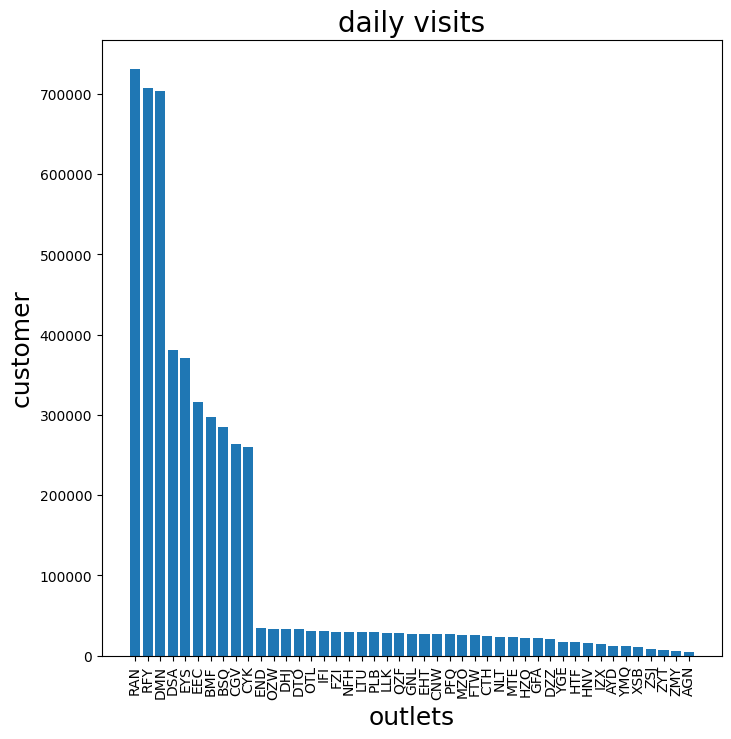

In [8]:
plt.figure(figsize=(8, 8))
x_pos = np.arange(len(jk.columns))
plt.bar(x_pos, jk.sum(), align='center')
plt.xticks(x_pos, jk.columns, rotation = 90)
plt.xlabel('outlets', fontsize=18)
plt.ylabel('customer', fontsize=18)
plt.title('daily visits', fontsize=20)
plt.show()

lets create a bar chart for high volume 

             RAN   RFY   DMN
Date                        
2021-01-01  2528  2304  1307
2021-01-02  1778  2027  2406
2021-01-03  1830  1871  2015
2021-01-04  1908  1732   978
2021-01-05  2123  1639  1334


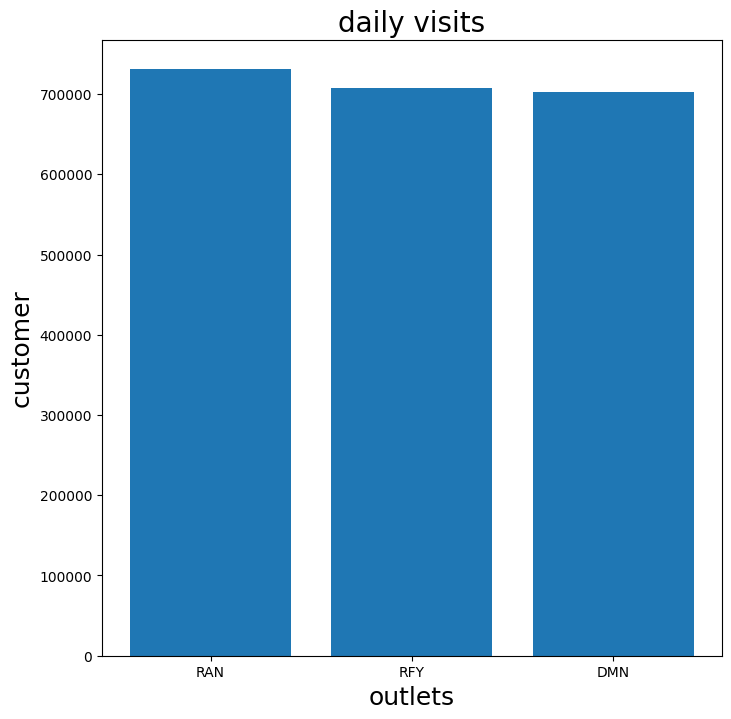

In [9]:
selected = ['RAN', 'RFY', 'DMN']
print(jk[selected].head())

plt.figure(figsize=(8, 8))
x_pos = np.arange(len(jk[selected].columns))
plt.bar(x_pos, jk[selected].sum(), align='center')
plt.xticks(x_pos, jk[selected].columns)
plt.xlabel('outlets', fontsize=18)
plt.ylabel('customer', fontsize=18)
plt.title('daily visits', fontsize=20)
plt.show()


let's create a code block which automatically classifies pages into high, medium and low volume by deciding bounaries for each data type. Here we are creating three different kind of calssification

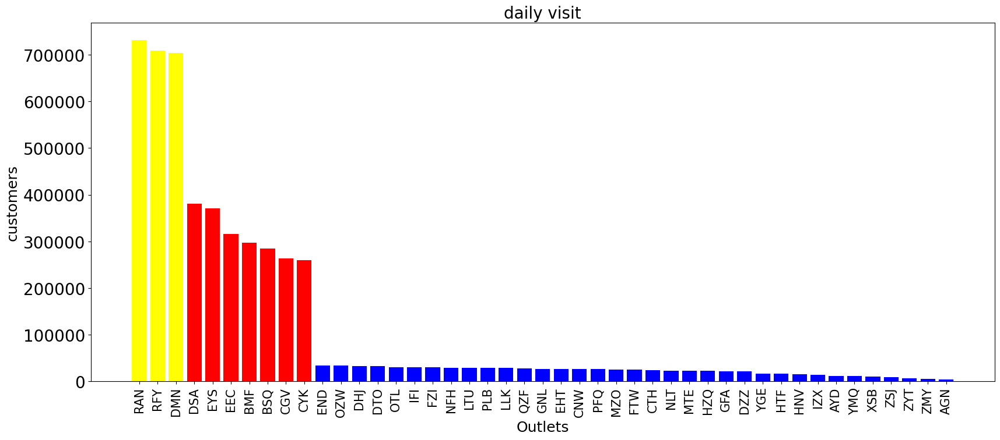

high volume of visitors: ['RAN', 'RFY', 'DMN']
medium volume of visitors: ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CGV', 'CYK']
low volume of visitors: ['END', 'OZW', 'DHJ', 'DTO', 'OTL', 'IFI', 'FZI', 'NFH', 'LTU', 'PLB', 'LLK', 'QZF', 'GNL', 'EHT', 'CNW', 'PFQ', 'MZO', 'FTW', 'CTH', 'NLT', 'MTE', 'HZQ', 'GFA', 'DZZ', 'YGE', 'HTF', 'HNV', 'IZX', 'AYD', 'YMQ', 'XSB', 'ZSJ', 'ZYT', 'ZMY', 'AGN']


In [10]:
categories = ['High', 'Medium', 'Low']
colours = []
High = []
Medium = []
Low = []
categories_selected = [[] for i in range(len(categories))]
for name in jk.columns:
    total_visits = jk[name].sum()
    if total_visits > 400000:
        category = 0
        colour ='yellow'
        High.append(name)
    elif total_visits > 100000:
        category = 1
        colour = 'red'
        Medium.append(name)
    else:
        category = 2
        colour = 'blue'
        Low.append(name)
    categories_selected[category].append(name)
    colours.append(colour)
   
plt.figure(figsize=(20, 8))
x_pos = np.arange(len(jk.columns))
plt.xticks(x_pos, jk.columns,rotation=90, fontsize=15)
plt.yticks(fontsize=20)
plt.bar(x_pos, jk.sum(), align='center', color = colours)
plt.xticks(x_pos, jk.columns)
plt.xlabel('Outlets', fontsize=18)
plt.ylabel('customers', fontsize=18)
plt.title('daily visit', fontsize=20)
plt.show()


print('high volume of visitors:',High)
print('medium volume of visitors:',Medium)
print('low volume of visitors:',Low)
    


## Lets analyse the outlets which is listed in medium category using Line PLot

             DSA   EYS   EEC  BMF  BSQ  CGV  CYK
Date                                            
2021-01-01  1152   842  1077  898  892  705  858
2021-01-02  1103  1295   924  691  833  895  855
2021-01-03  1003   862   759  790  747  622  765
2021-01-04   920   902   703  977  641  733  681
2021-01-05   864  1042   616  805  693  851  723


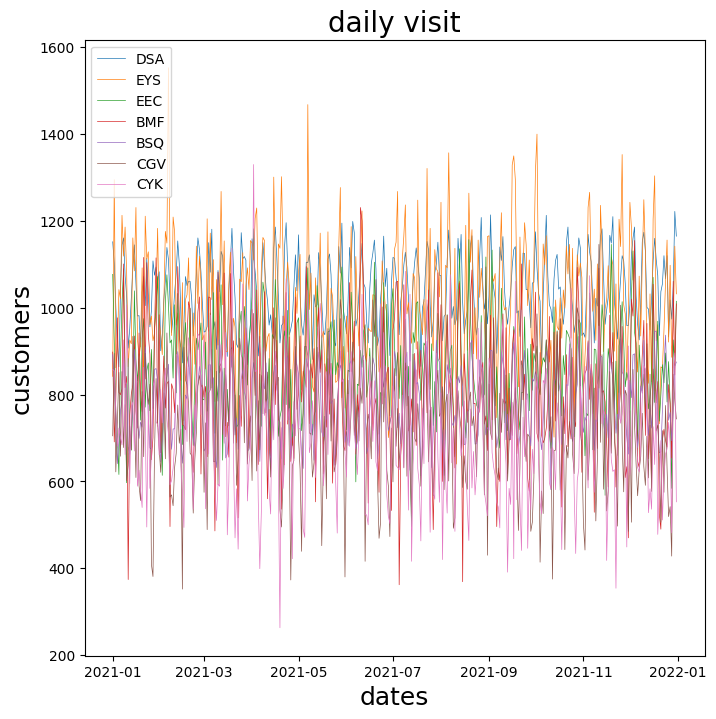

In [11]:
selected = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CGV', 'CYK']
print(jk[selected].head())

plt.figure(figsize=(8, 8))
plt.plot(jk[selected], linewidth=0.5)
plt.xlabel('dates', fontsize=18)
plt.ylabel('customers', fontsize=18)
plt.title('daily visit', fontsize=20)
plt.legend(selected, loc=2)
plt.show()


lets analyse the medium range for one month visits

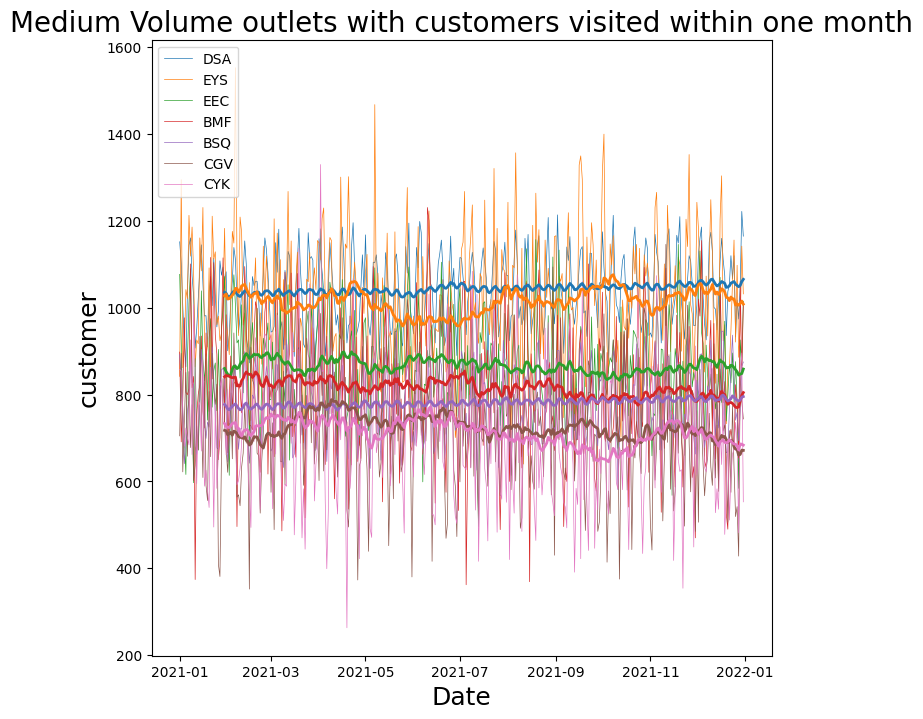

In [12]:
period = 30
rolling_average = jk.rolling(window=period).mean()

plt.figure(figsize=(8, 8))
plt.plot(jk[selected], linewidth=0.5)
plt.gca().set_prop_cycle(None)
plt.plot(rolling_average[selected], linewidth=2)
# plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('customer', fontsize=18)
plt.title('Medium Volume outlets with customers visited within one month', fontsize=20)
plt.legend(selected, loc=2)
plt.show()

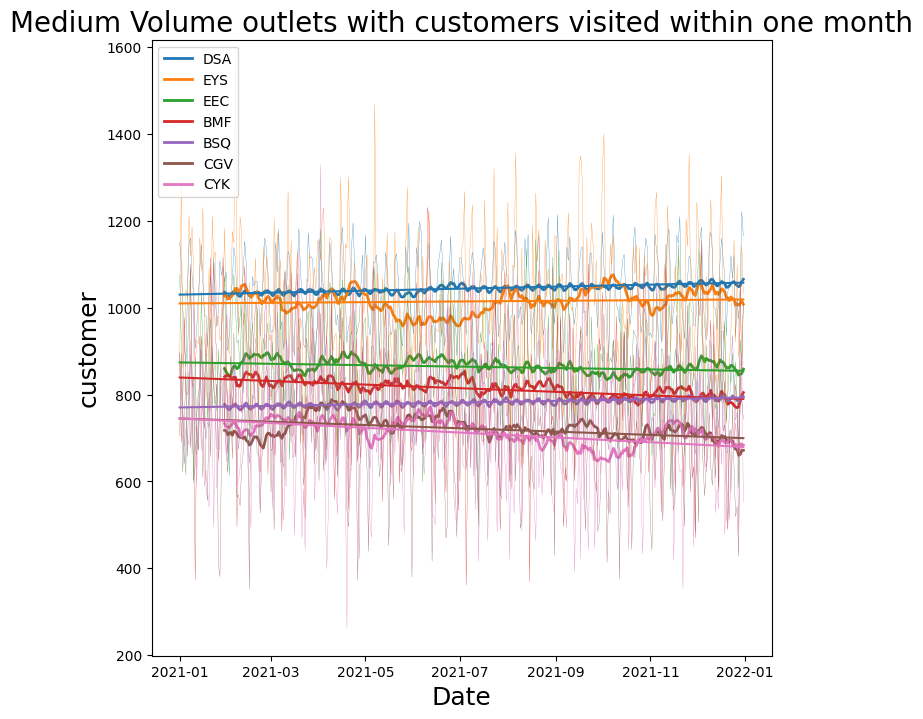

In [13]:
plt.figure(figsize=(8, 8))
plt.plot(rolling_average[selected], linewidth=2)
plt.gca().set_prop_cycle(None)
plt.plot(jk[selected], linewidth=0.2)
plt.gca().set_prop_cycle(None)

for name in selected:
    x = np.arange(len(jk[name]))
    z = np.polyfit(x, jk[name], 1)
    trend = np.poly1d(z)
    plt.plot(jk.index, trend(x), linestyle='-')
# plt.ylim(ymin=0)
plt.xlabel('Date', fontsize=18)
plt.ylabel('customer', fontsize=18)
plt.title('Medium Volume outlets with customers visited within one month', fontsize=20)
plt.legend(selected, loc=2)
plt.show()

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
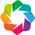

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [14]:
plot = jk[Medium].hvplot.line(
    frame_height=250, frame_width=2000,
    xlabel='Date', ylabel='customers',
    title='Daily customer visiting', legend='top'
)
#hvplot.show(plot)
hv.extension('bokeh')
plot

## lets analyse the outlets which is listed in low category using box plot

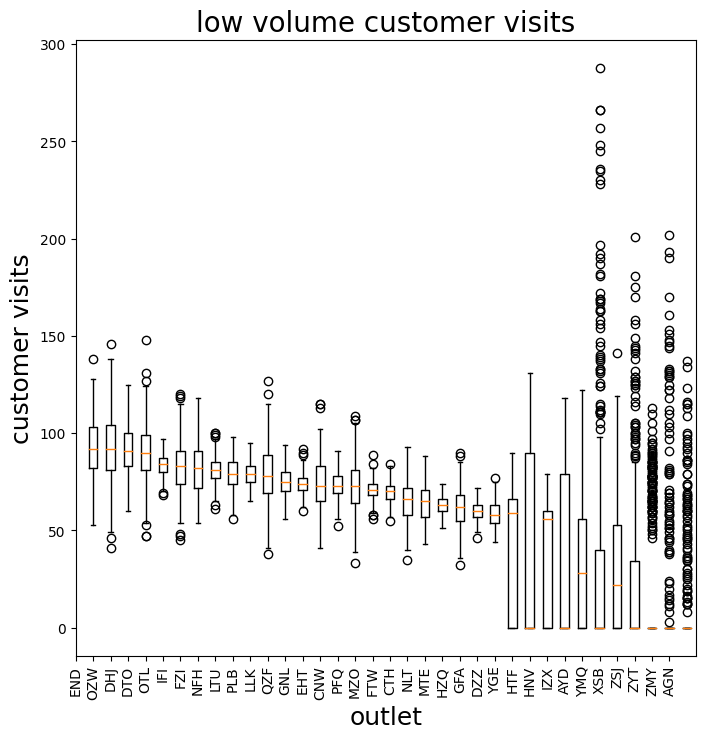

In [36]:
selected =  ['END', 'OZW', 'DHJ', 'DTO', 'OTL', 'IFI', 'FZI', 'NFH', 'LTU', 'PLB', 'LLK', 'QZF', 'GNL', 'EHT', 'CNW', 'PFQ', 'MZO', 'FTW', 'CTH', 'NLT', 'MTE', 'HZQ', 'GFA', 'DZZ', 'YGE', 'HTF', 'HNV', 'IZX', 'AYD', 'YMQ', 'XSB', 'ZSJ', 'ZYT', 'ZMY', 'AGN']
plt.figure(figsize=(8, 8))
# data[selected].boxplot()
plt.boxplot(jk[selected], labels=selected)
plt.xticks(x_pos, jk[selected].columns, rotation = 90)
plt.xlabel('outlet', fontsize=18,)
plt.ylabel('customer visits', fontsize=18)
plt.title('low volume customer visits', fontsize=20)
plt.show()


            END  OZW  DHJ  DTO  OTL  IFI  FZI  NFH  LTU  PLB  ...  HTF  HNV  \
Date                                                          ...             
2021-01-01   81   69   81   98   78   82   87   90   76   92  ...  105   52   
2021-01-02   92   82  103   76   81   60   77   73   70   83  ...   98   57   
2021-01-03   70  105   80  104   79   75   58   84   94   73  ...   72   59   
2021-01-04   56  102  105   92   87   85   75   74   66   72  ...   78   59   
2021-01-05  101   81   75   96   72   90   91   80   79   84  ...  109   61   

            IZX  AYD  YMQ  XSB  ZSJ  ZYT  ZMY  AGN  
Date                                                
2021-01-01   82    0    0    0    0   91    0    0  
2021-01-02  113    0    0    0    0   78    0    0  
2021-01-03   92    0    0    0    0   85    0    0  
2021-01-04   58    0    0    0    0   60    0    0  
2021-01-05   71    0    0    0    0   48    0    0  

[5 rows x 35 columns]


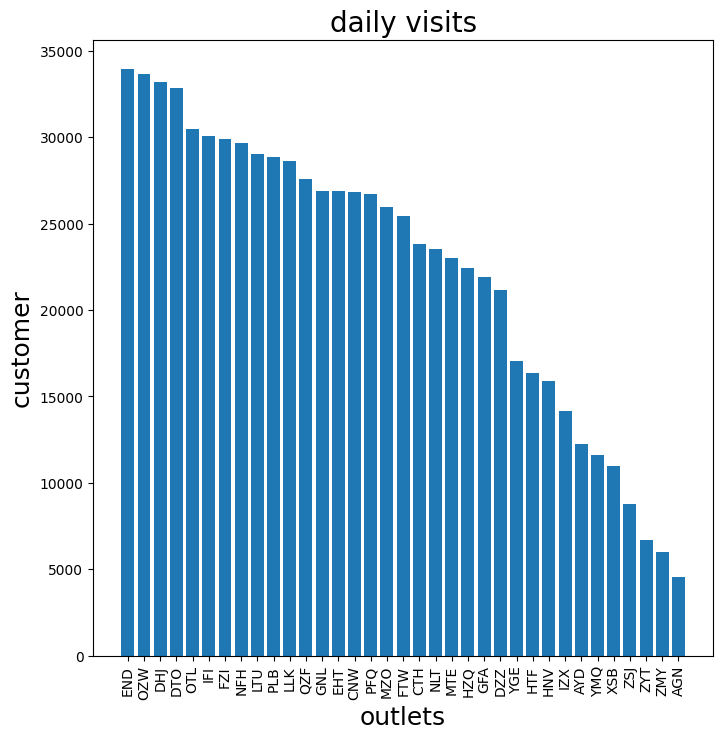

In [35]:
selected =  ['END', 'OZW', 'DHJ', 'DTO', 'OTL', 'IFI', 'FZI', 'NFH', 'LTU', 'PLB', 'LLK', 'QZF', 'GNL', 'EHT', 'CNW', 'PFQ', 'MZO', 'FTW', 'CTH', 'NLT', 'MTE', 'HZQ', 'GFA', 'DZZ', 'YGE', 'HTF', 'HNV', 'IZX', 'AYD', 'YMQ', 'XSB', 'ZSJ', 'ZYT', 'ZMY', 'AGN']

print(jk[selected].head())

plt.figure(figsize=(8, 8))
x_pos = np.arange(len(jk[selected].columns))
plt.bar(x_pos, jk[selected].sum(), align='center')
plt.xticks(x_pos, jk[selected].columns, rotation = 90)
plt.xlabel('outlets', fontsize=18)
plt.ylabel('customer', fontsize=18)
plt.title('daily visits', fontsize=20)
plt.show()

## lets analyse the outlets which is listed in high volume category using line area plot and box plot

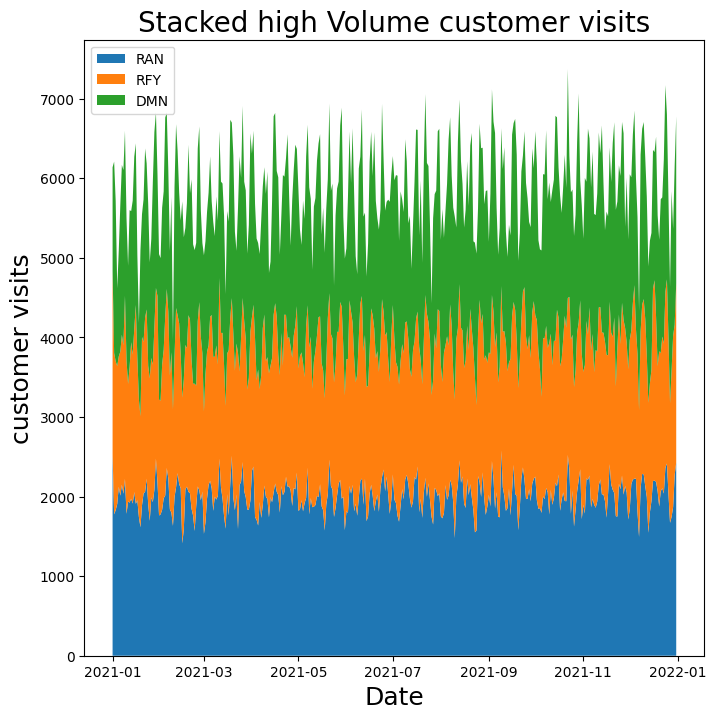

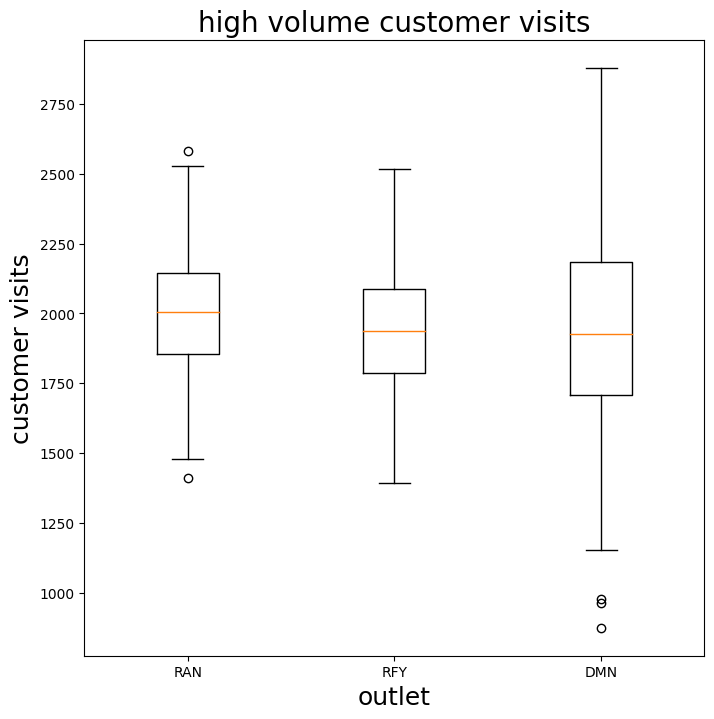

In [16]:
selected = ['RAN', 'RFY', 'DMN']



plt.figure(figsize=(8, 8))
# data.plot.area(figsize=(8, 8))
plt.stackplot(jk.index, jk[selected].transpose())
plt.xlabel('Date', fontsize=18)
plt.ylabel('customer visits', fontsize=18)
plt.title('Stacked high Volume customer visits', fontsize=20)
plt.legend(selected, loc=2)
plt.show()

plt.figure(figsize=(8, 8))
plt.boxplot(jk[selected], labels=selected)
plt.xlabel('outlet', fontsize=18,)
plt.ylabel('customer visits', fontsize=18)
plt.title('high volume customer visits', fontsize=20)
plt.show()

## interactive visualization of high volume outlets using histograms and line plots

221 bins


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
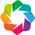

:NdOverlay   [Element]
   :Histogram   [DMN]   (DMN_count)

In [17]:
selected = ['RAN', 'RFY', 'DMN']
x_min = 800
x_max = 3000
bin_width = 10
n_bins = int((bin_width + x_max - x_min) / bin_width)
print(str(n_bins) + ' bins')
bins = [(x_min + x * (bin_width + x_max - x_min) / n_bins) for x in range(int(n_bins))]

plot = jk[selected].hvplot.hist(
    frame_height=500, frame_width=500,
    xlabel='customer visits', ylabel='Frequency',
    title='high volume outlets',
    alpha=0.5, muted_alpha=0, muted_fill_alpha=0, muted_line_alpha=0,
    tools=['pan', 'box_zoom', 'wheel_zoom', 'undo', 'redo', 'hover', 'save', 'reset'],
    bins=bins
)
hv.extension('bokeh')
plot


<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
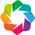

:NdOverlay   [Variable]
   :Curve   [Date]   (value)

In [18]:
selected = ['RAN', 'RFY', 'DMN']

plot = jk[selected].hvplot.line(
    frame_height=500, frame_width=500,
    xlabel='Date', ylabel='customers',
    title='customers visiting daily'
)
hv.extension('bokeh')
plot

## customer visiting correlation among medium outlets

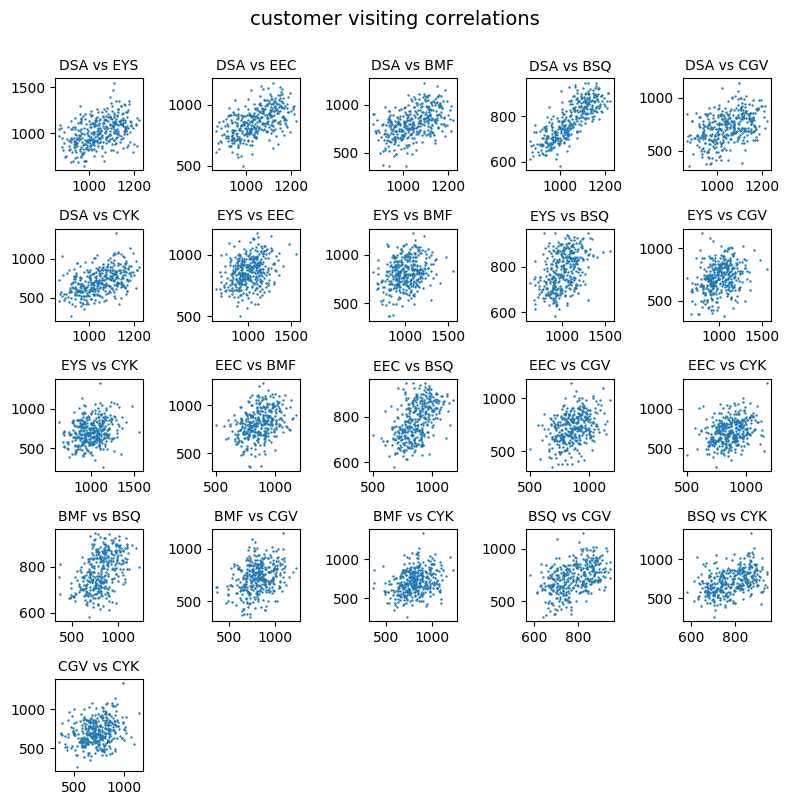

In [19]:
selected = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CGV', 'CYK']

counter = 1
fig = plt.figure(figsize=(8, 8))
fig.suptitle('customer visiting correlations', fontsize=14, position=(0.5, 1.0))
for i, name_i in enumerate(selected):
    for j in range(i + 1, len(selected)):
        name_j = selected[j]
        sub = fig.add_subplot(5, 5, counter)
        sub.set_title(name_i + ' vs ' + name_j, fontsize=10)
        sub.scatter(jk[name_i], jk[name_j], s=0.5)
        counter += 1
plt.subplots_adjust(wspace=0.5, hspace=0.5)
plt.tight_layout()
plt.show()

## create a seasonal visualization for medium outlet

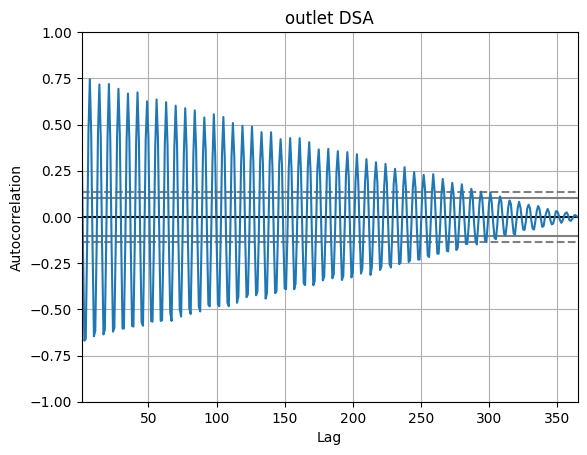

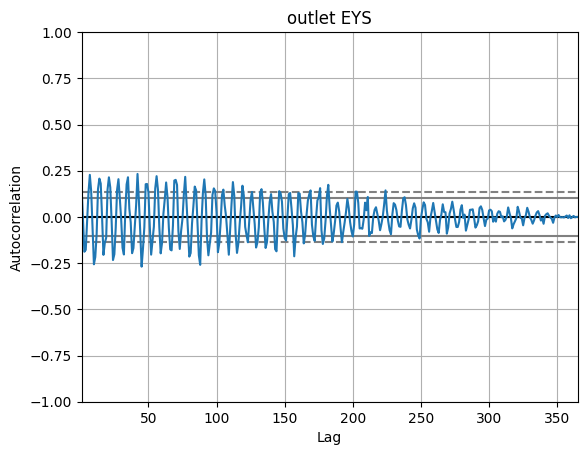

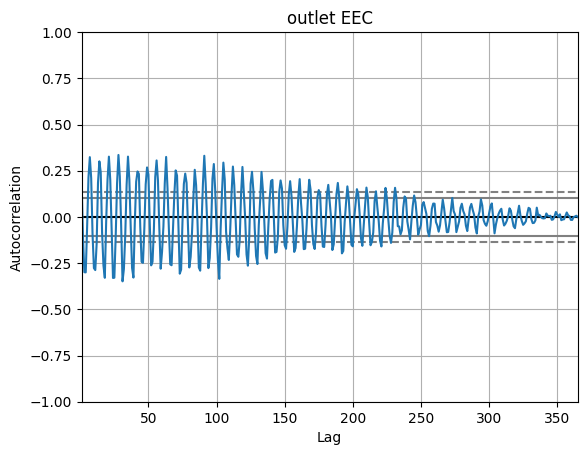

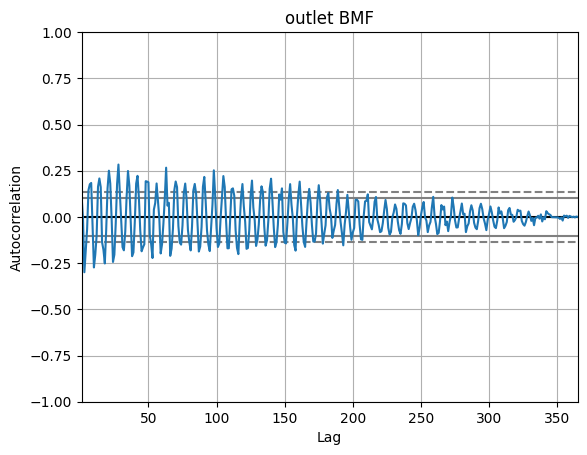

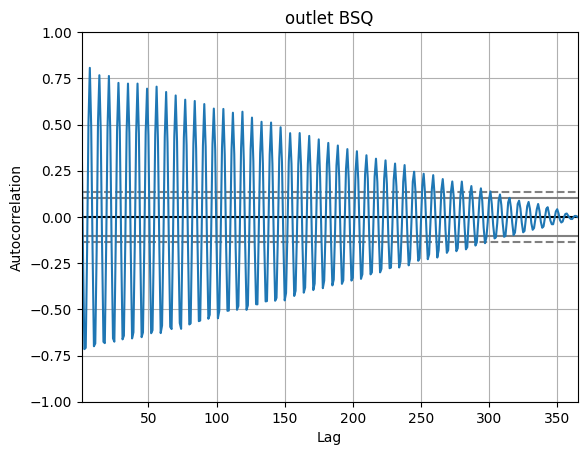

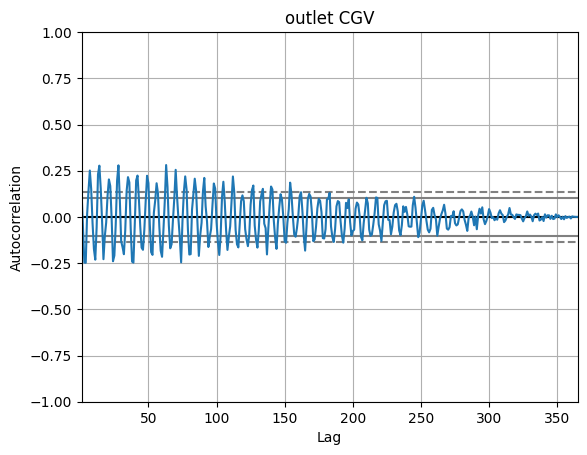

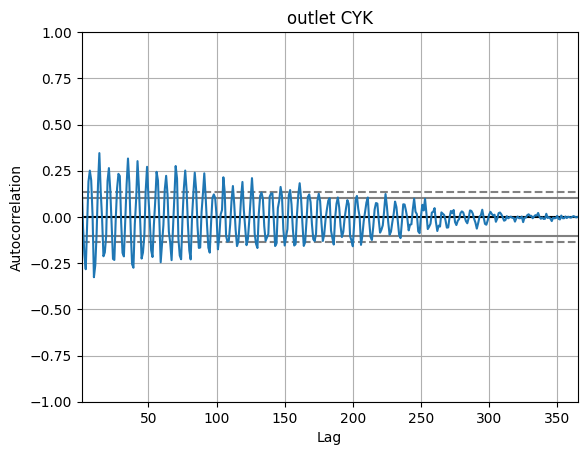

In [20]:
selected = ['DSA', 'EYS', 'EEC', 'BMF', 'BSQ', 'CGV', 'CYK']
for name in selected:
    pd.plotting.autocorrelation_plot(jk[name])
    plt.title('outlet ' + name)
    plt.show()

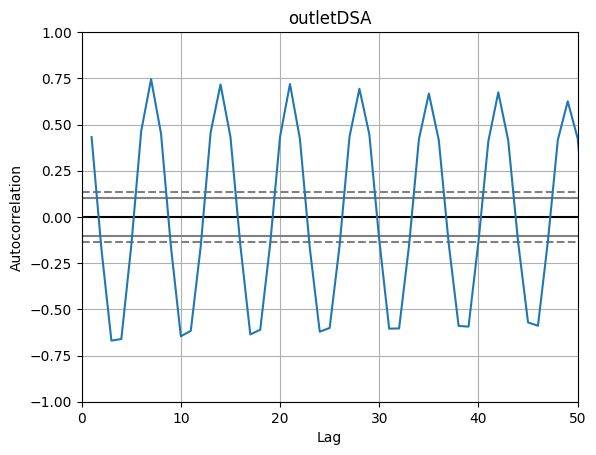

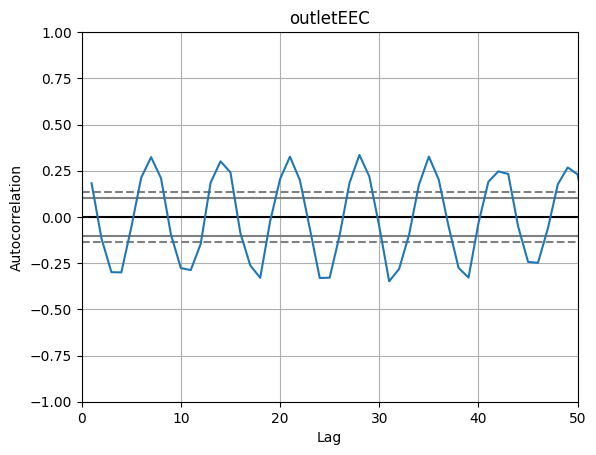

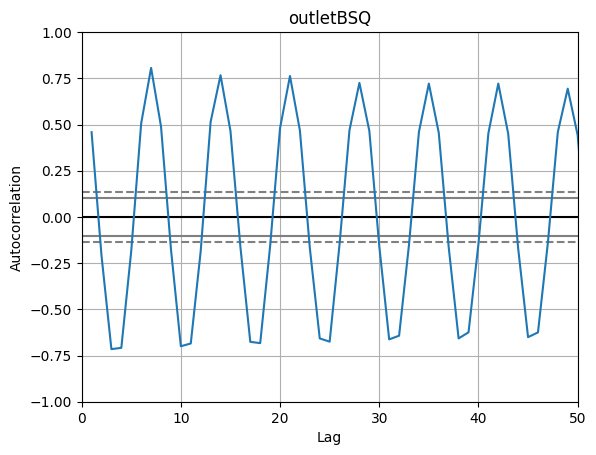

In [21]:
selected = ['DSA', 'EEC', 'BSQ']
for name in selected:
    pd.plotting.autocorrelation_plot(jk[name])
    plt.xlim([0, 50])
    plt.title('outlet' + name)
    plt.show()

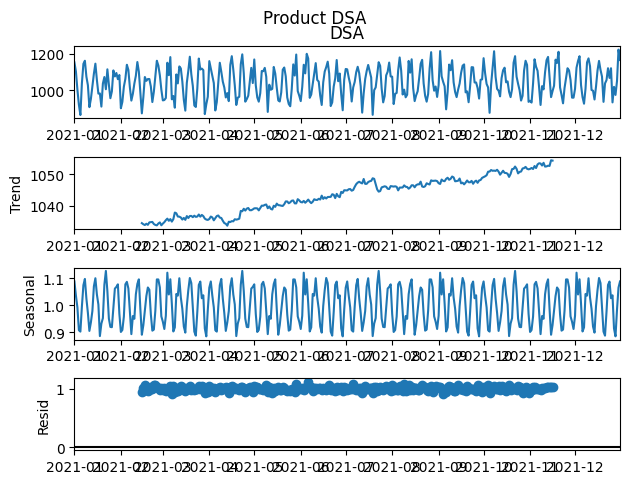

In [22]:
from statsmodels.tsa.seasonal import seasonal_decompose
selected = ['DSA']
for name in selected:
    result = seasonal_decompose(jk[name], model='multiplicative', period=91)
    result.plot()
    plt.suptitle('Product ' + name, position=(0.5, 1.0))
    plt.show()


# Data-Frame - 2: Summary data table 

In [23]:
jk2 = pd.read_csv('https://tinyurl.com/ChrisCoDV/001272844/OutletDailyCustomers.csv', index_col=0)

marketing_data = pd.read_csv('https://tinyurl.com/ChrisCoDV/001272844/OutletMarketing.csv', index_col=0)
outlet_overhead = pd.read_csv('https://tinyurl.com/ChrisCoDV/001272844/OutletOverheads.csv', index_col=0)
outlet_size = pd.read_csv('https://tinyurl.com/ChrisCoDV/001272844/OutletSize.csv', index_col=0)
outlet_staff = pd.read_csv('https://tinyurl.com/ChrisCoDV/001272844/OutletStaff.csv', index_col=0)

summary_data = pd.DataFrame(index=jk2.columns)
summary_data['outlet staff'] = outlet_staff.values
summary_data['daily visit'] = jk2.sum().values
summary_data['outlet size'] = outlet_size.values
summary_data['market'] = marketing_data.values
summary_data['overhead'] = outlet_overhead.values

print(summary_data.head())



     outlet staff  daily visit  outlet size  market  overhead
NFH             4        29682          315    3000     22000
LTU             2        29025          128    4000     87000
YGE             2        17068          179    2000     52000
CYK            18       260008         2699   24000     78000
HTF             1        16381          102    2000     87000


## creating bar chart subplots for all 6 values

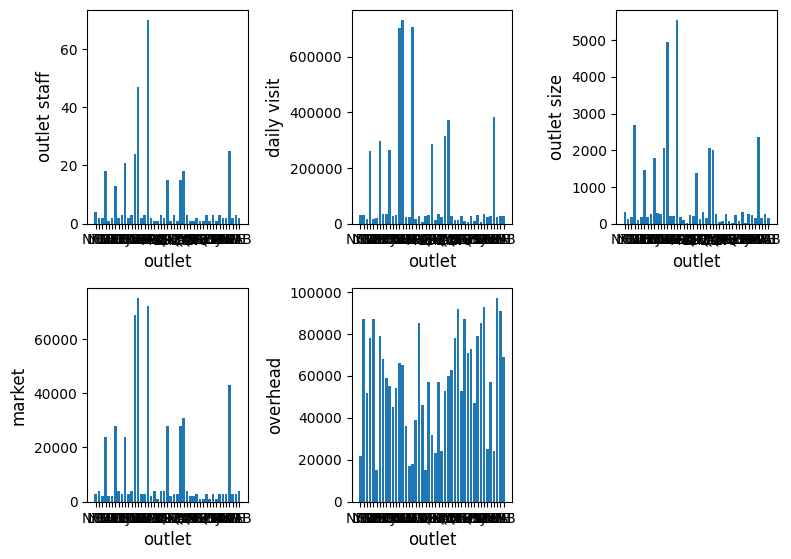

In [24]:
plt.figure(figsize=(8, 8))
counter = 1
x_pos = np.arange(len(summary_data.index))
for attribute in summary_data:
    sub = plt.subplot(3, 3, counter)
    sub.bar(x_pos, summary_data[attribute], align='center')
    sub.set_xticks([])
    sub.set_xticks(x_pos)
    sub.set_xticklabels(summary_data.index)
    sub.set_xlabel('outlet', fontsize=12)
    sub.set_ylabel(attribute, fontsize=12)
    counter += 1
plt.tight_layout()
plt.show()

## visualizing the high volume outlets using radar subplots

     outlet staff  daily visit  outlet size    market  overhead
NFH      0.057143     0.040597     0.056767  0.040000  0.226804
LTU      0.028571     0.039698     0.023067  0.053333  0.896907
YGE      0.028571     0.023344     0.032258  0.026667  0.536082
CYK      0.257143     0.355622     0.486394  0.320000  0.804124
HTF      0.014286     0.022405     0.018382  0.026667  0.896907


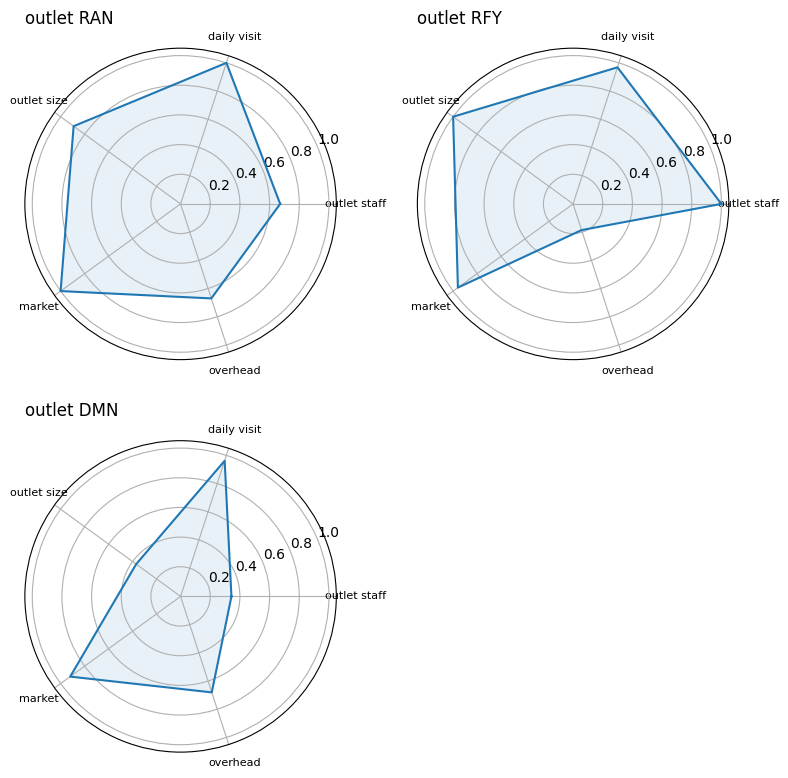

In [25]:
normalised_data = summary_data / summary_data.max()
print(normalised_data.head())

selected = ['RAN', 'RFY', 'DMN']

n_attributes = len(normalised_data.columns)
angles = [n / float(n_attributes) * 2 * np.pi for n in range(n_attributes + 1)]
plt.figure(figsize=(8, 8))
counter = 1
for name in selected:
    values = normalised_data.loc[[name]].values.flatten().tolist()
    values += values[:1]
    sub = plt.subplot(2, 2, counter, polar=True)
    sub.plot(angles, values)
    sub.fill(angles, values, alpha=0.1)
    sub.set_ylim(ymax=1.05)
    sub.set_yticks([0.2, 0.4, 0.6, 0.8, 1.0])
    sub.set_xticks(angles[0:-1])
    sub.set_xticklabels(normalised_data.columns, fontsize=8)
    sub.set_title('outlet ' + name, fontsize=12, loc='left')
    counter += 1
plt.tight_layout()
plt.show()


## creating correlogram for all metrices

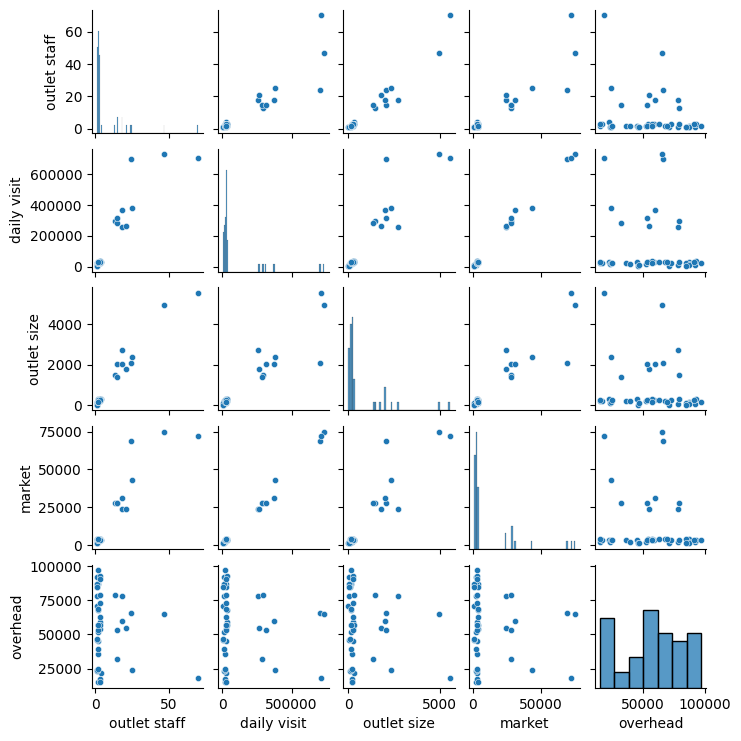

In [26]:
sns.pairplot(summary_data, height=1.5, plot_kws={'s': 20})
plt.show()

## heatmap

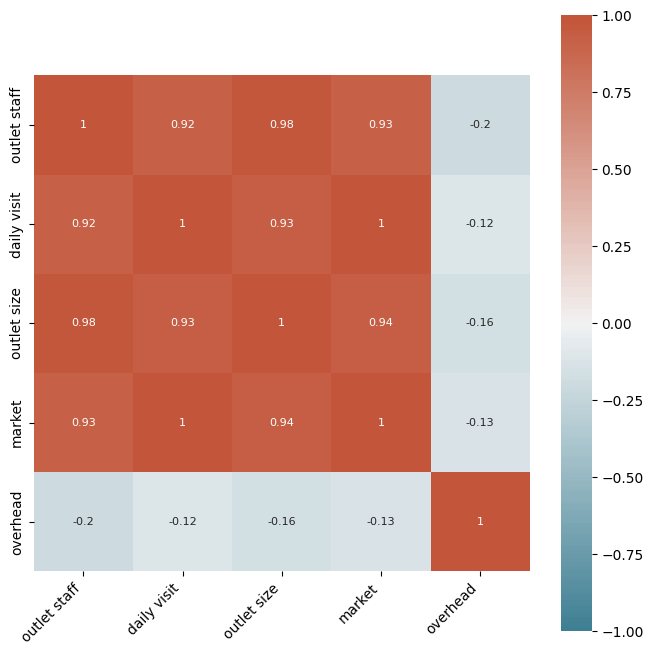

In [27]:
plt.figure(figsize=(8, 8))
corr = summary_data.corr()
ax = sns.heatmap(corr, vmin=-1, vmax=1, center=0, cmap=sns.diverging_palette(220, 20, n=200), square=True, annot=True,
                 annot_kws={"size": 8})
ax.set_xticklabels(ax.get_xticklabels(), rotation=45, horizontalalignment='right')
plt.show()